In [1]:
import sys
sys.path.append('/media/raid/graham/compute/compute/CellHier/graham/cellhier/')
from cellhier.general import *
%load_ext autoreload
%autoreload 2
import pandas as pd
import numpy as np
%matplotlib inline
# %pylab inline
from matplotlib import pyplot as plt
import skimage
import pickle
import seaborn as sns

In [6]:
os.chdir('/media/raid/graham/compute/compute/CellHier/graham')
cells = cells.read_pickle('SoftwarePackagePaper/submissiondata/cells_before_cns')

In [17]:
cells = cells[['Exp','X','Y','Cluster name2','100']]

In [18]:
cells.head()

,Exp,X,Y,Cluster name2,100
0,tonsil9338,7.0,1605.0,B cells - (CD19/CD22/CD40),16
1,tonsil9338,77.0,1659.0,B cells - (CD19/CD22/CD40),14
2,tonsil9338,12.0,1992.0,B cells - (CD19/CD22/CD40),8
3,tonsil9338,86.0,1707.0,B cells - (CD19/CD22/CD40),8
4,tonsil9338,124.0,1676.0,B cells - (CD19/CD22/CD40),83


In [19]:
ks = [10,20,30]
cluster_col = 'Cluster name2'
exclude_cols = ['ECM']
sum_cols = list(cells[cluster_col].unique())
# sum_cols = list(range(50))#['50_{}'.format(i) for i in range(50)]
cluster_cols = [a for a in sum_cols if a not in exclude_cols]
keep_cols = ['Exp','X','Y',cluster_col,'100']
X = 'X'
Y = 'Y'

In [20]:
from cellhier.knn_graph_neighborhood import Neighborhoods
from sklearn.cluster import MiniBatchKMeans

In [21]:
Neigh2 = Neighborhoods(cells,ks = [10,20,30],cluster_col = 'Cluster name2',
                      sum_cols=sum_cols,
                      keep_cols=keep_cols,X = 'X',Y='Y',add_dummies=True)
cluster_name2_windows = Neigh2.k_windows()


Starting: 3/4 : LN
Finishing: 3/4 : LN 2.7367467880249023 2.7370946407318115
Starting: 4/4 : spleen
Finishing: 4/4 : spleen 3.6750807762145996 6.4340291023254395
Starting: 2/4 : tonsil8953
Finishing: 2/4 : tonsil8953 3.4651668071746826 9.929434061050415
Starting: 1/4 : tonsil9338
Finishing: 1/4 : tonsil9338 3.4326133728027344 13.388563394546509


In [22]:
BASE = cells[keep_cols]

In [25]:
for k in [20]:
    for n_clusters in [11]:
#         print ('normalizing', k)
        X_ = cluster_name2_windows[k][cluster_cols].values
    #     X = transform_major_cells(X_,thresh = .2)
        X = X_/X_.sum(1,keepdims = True)
        X[np.isnan(X)] = 0
        print ('clustering - ws:{} n_clusters: {}'.format(k,n_clusters))
        col_name = 'cluster_col{}_ws{}_clusts{}_noECM'.format(cluster_col,k,n_clusters)
        assert col_name not in BASE.columns
        BASE[col_name] = MiniBatchKMeans(random_state = 5,n_clusters=n_clusters).fit(X).labels_
    


/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: invalid value encountered in true_divide
  


clustering - ws:20 n_clusters: 11


In [26]:
colors = [(0.00784313725490196, 0.24313725490196078, 1.0),
 (1.0, 0.48627450980392156, 0.0),
 (0.10196078431372549, 0.788235294117647, 0.2196078431372549),
 (0.9098039215686274, 0.0, 0.043137254901960784),
 (0.5450980392156862, 0.16862745098039217, 0.8862745098039215),
 (0.6235294117647059, 0.2823529411764706, 0.0),
 (0.9450980392156862, 0.2980392156862745, 0.7568627450980392),
 (0.6392156862745098, 0.6392156862745098, 0.6392156862745098),
 (1.0, 0.7686274509803922, 0.0),
 (0.0, 0.8431372549019608, 1.0),
 (0.0, 0.40790465, 0.16444444),
 (0.40392157, 0.0, 0.05098039),
 (0.0, 0.8431372549019608, 1.0),
 (0.0, 0.0, 0.0)]

tonsil9338


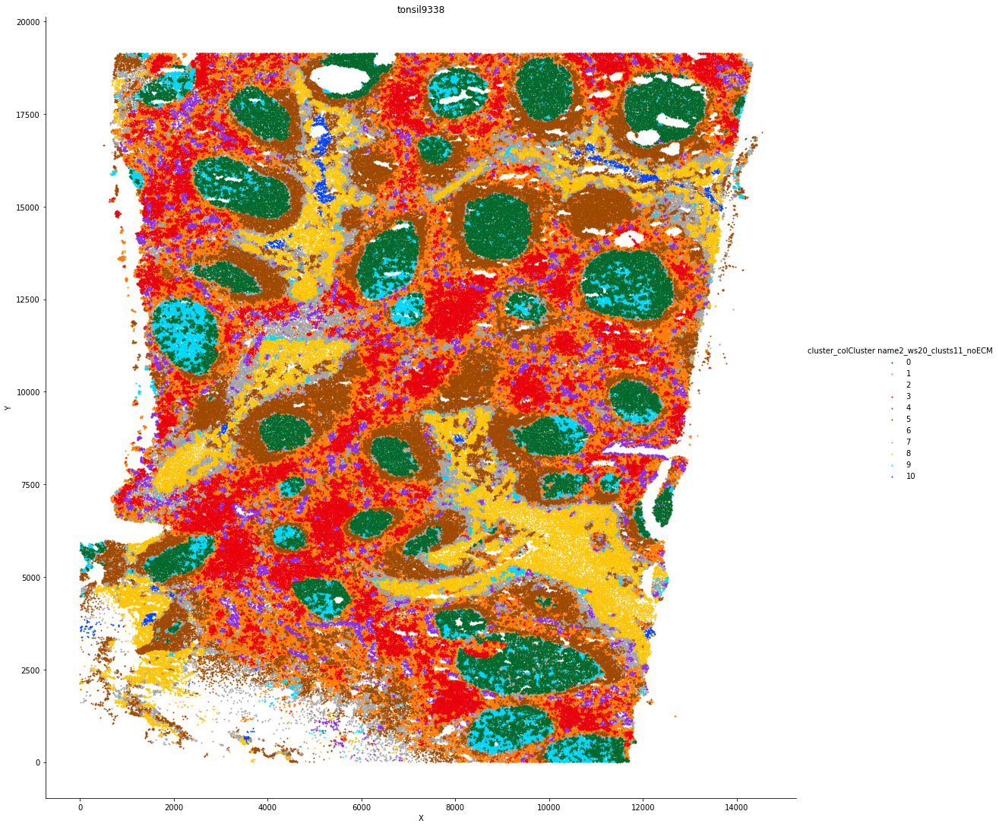

tonsil8953


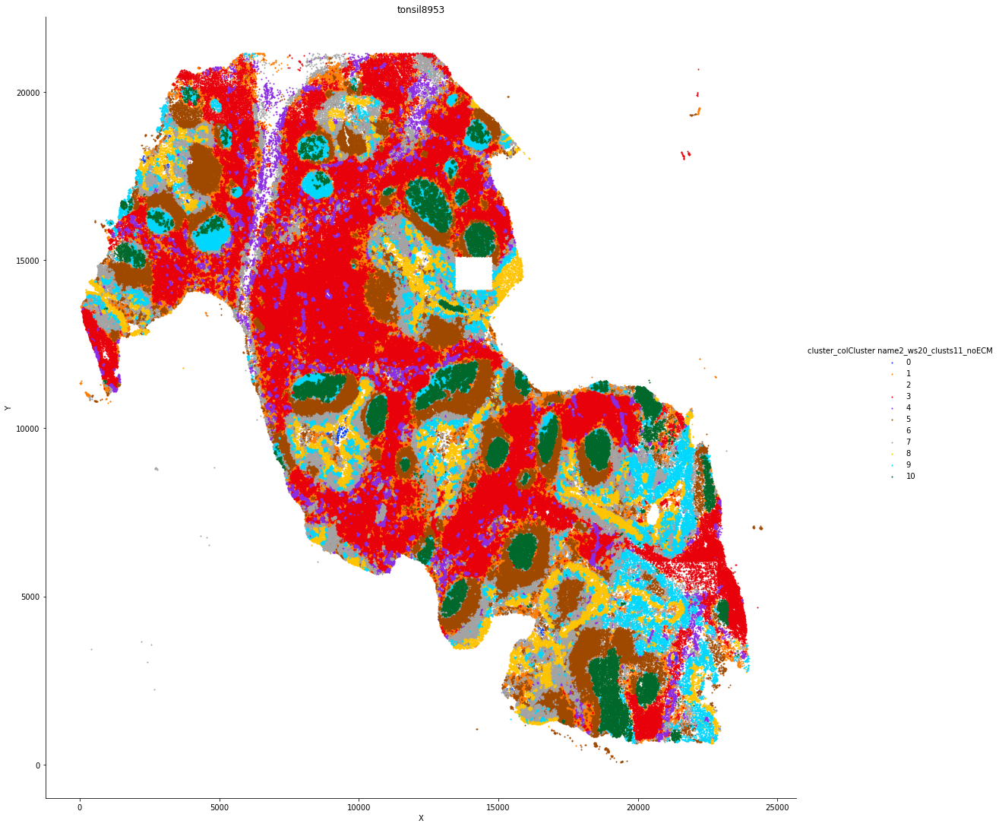

LN


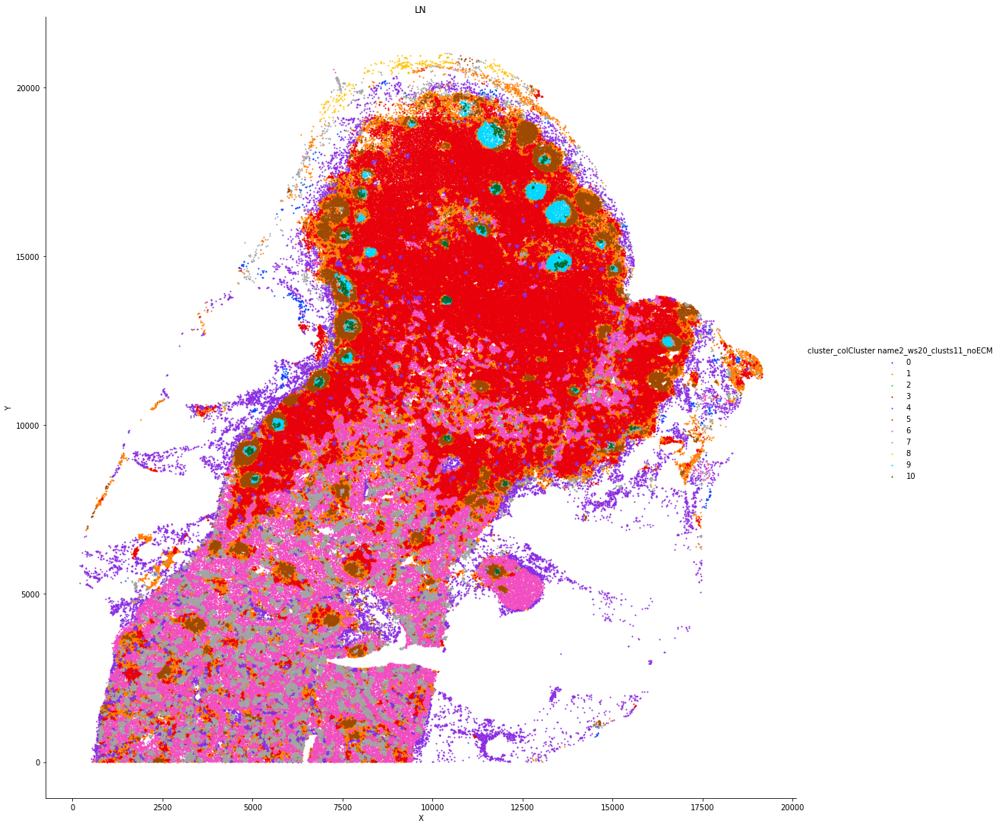

spleen


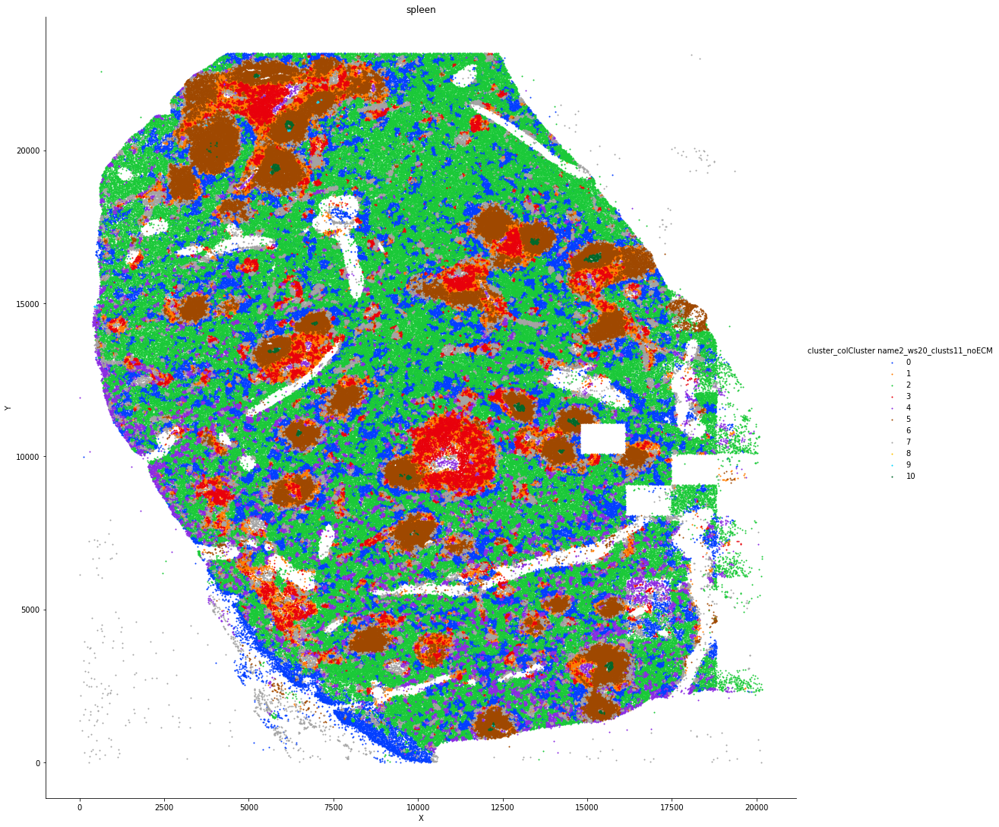

In [27]:
catplot(BASE,hue = 'cluster_colCluster name2_ws20_clusts11_noECM',
        palette = {i:colors[i] for i in range(len(colors))},figsize = 15,size = 4)

## note cyan CN in epithelium.  Merge with epithelium

In [40]:

#umap of cells allocated to cn9 (cyan) was computed using window frequencies of cell types and gated manually
#isprolif = 'Proliferating B cells (CD19/Ki67)'>2 cells per window
#isepi = 'Epithelial cells'>0
cn9 = pd.read_pickle('SoftwarePackagePaper/submissiondata/cyan_epi_correction')

BASE2 = BASE#[my_cols]

BASE2['final_neigh'] = BASE2['cluster_colCluster name2_ws20_clusts11_noECM'].values
BASE2.loc[cn9[(cn9['final_gate']==False)|(cn9['Exp']=='spleen')].index,'final_neigh']= 'Other'
BASE2.loc[cn9[(cn9['final_gate']==True)|(cn9['Exp'].isin(['LN']))].index,'final_neigh']= 'DZ'


#remove small section of tonsil8953 with bright imaging artifacts
BASE2_t89 = BASE2[(BASE2['Exp'].isin(['tonsil9338','LN','spleen']))]
t89 = BASE2[BASE2['Exp']=='tonsil8953'].query('19200>X & 4000<Y')
BASE3 = pd.concat([BASE2_t89,t89],0)

BASE3['final_neigh2'] = BASE3['final_neigh']
BASE3.loc[BASE3['final_neigh']=='Other','final_neigh2'] = 8

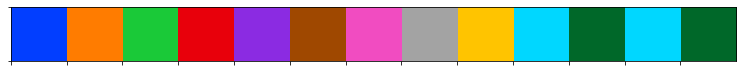

In [42]:
pal = {0: (0.00784313725490196, 0.24313725490196078, 1.0),
 1: (1.0, 0.48627450980392156, 0.0),
 2: (0.10196078431372549, 0.788235294117647, 0.2196078431372549),
 3: (0.9098039215686274, 0.0, 0.043137254901960784),
 4: (0.5450980392156862, 0.16862745098039217, 0.8862745098039215),
 5: (0.6235294117647059, 0.2823529411764706, 0.0),
 6: (0.9450980392156862, 0.2980392156862745, 0.7568627450980392),
 7: (0.6392156862745098, 0.6392156862745098, 0.6392156862745098),
 8: (1.0, 0.7686274509803922, 0.0),
 10: (0.0, 0.8431372549019608, 1.0),
 9: (0.0, 0.40790465, 0.16444444),
 'LZ': (0.0, 0.8431372549019608, 1.0),
      'DZ':(0.0, 0.40790465, 0.16444444)}
sns.palplot(pal.values())

tonsil9338


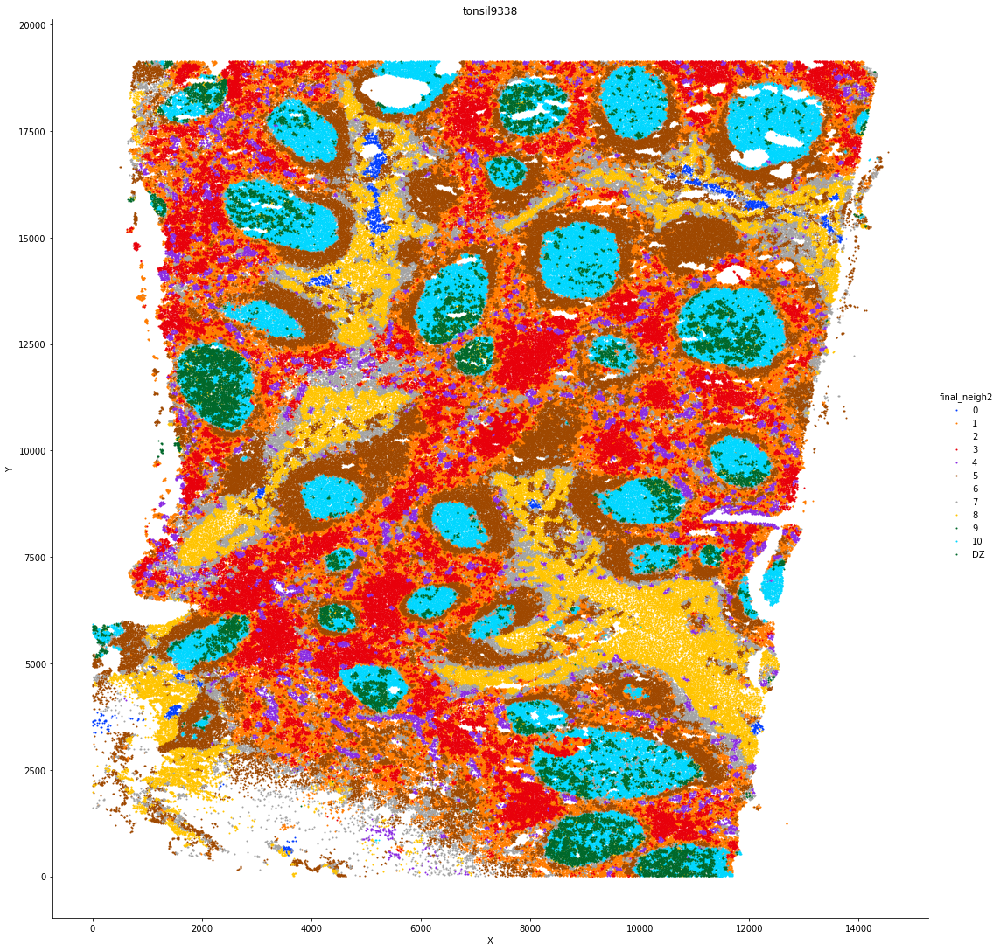

LN


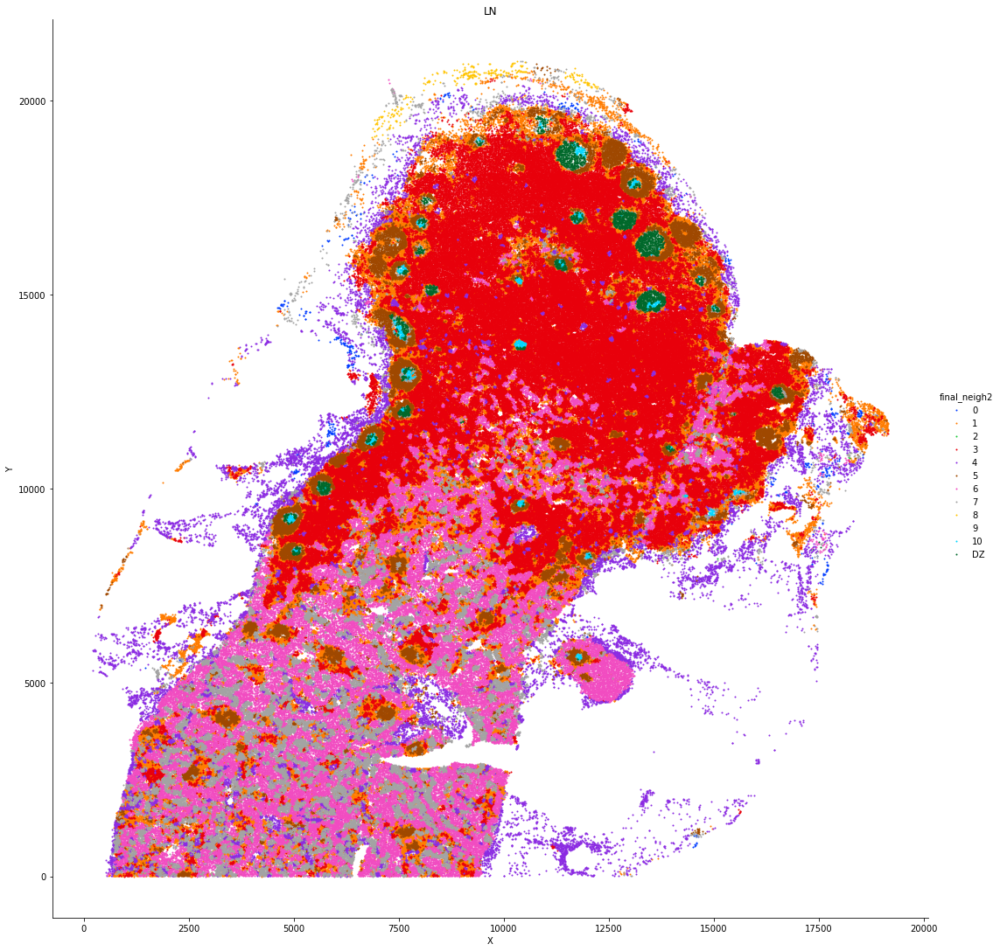

spleen


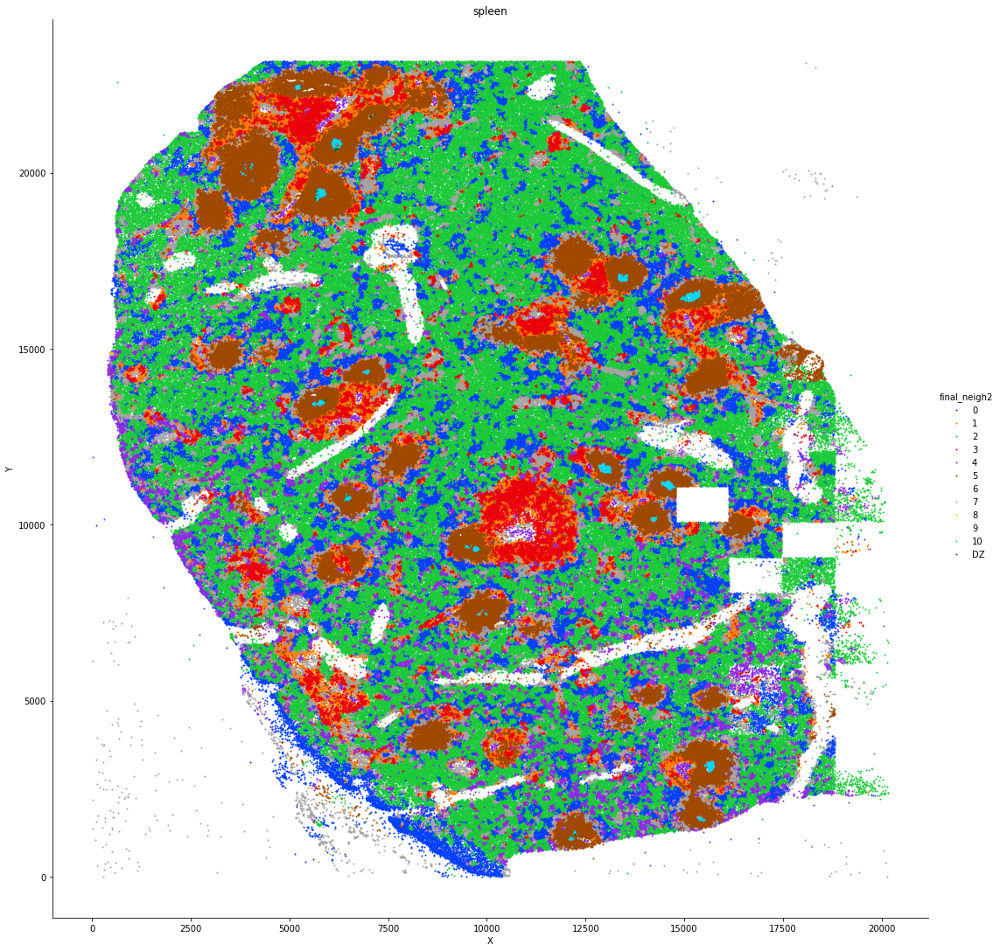

tonsil8953


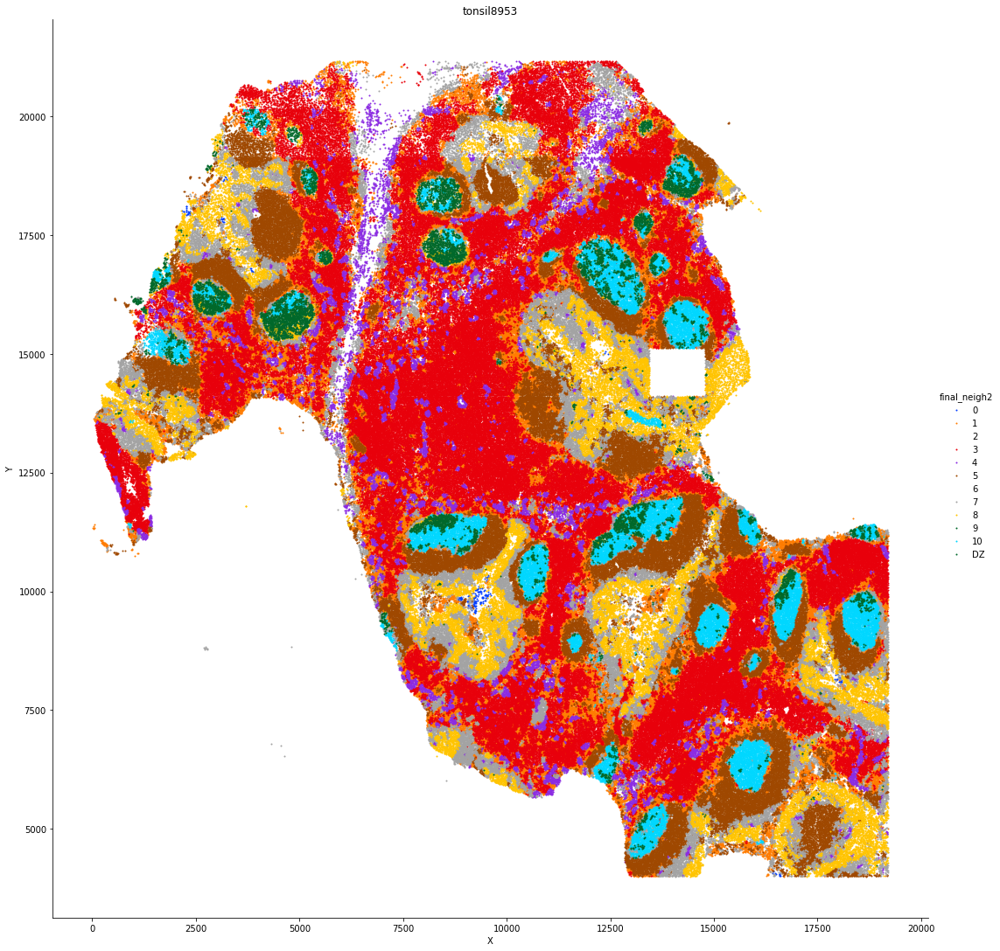

In [43]:
catplot(BASE3,hue = 'final_neigh2',
        palette = pal,figsize = 15,size = 4)

## Redo neighborhoods for GC using newly clustered cell types

In [44]:
exp_names =  cells['Exp'].unique()

In [45]:
cts = [59, 61, 7, 46, 49, 22, 38, 11, 31, 53, 70]

In [47]:
BASE3 = BASE3.reset_index()

In [49]:
Neigh2 = Neighborhoods(BASE3,ks = [10,20,30],cluster_col = '100',
                      sum_cols=range(100),
                      keep_cols=BASE3.columns,X = 'X',Y='Y',add_dummies=True)
foll_windows = Neigh2.k_windows()

Starting: 2/4 : LN
Finishing: 2/4 : LN 2.78033447265625 2.780698776245117
Starting: 3/4 : spleen
Finishing: 3/4 : spleen 3.6958000659942627 6.497967481613159
Starting: 4/4 : tonsil8953
Finishing: 4/4 : tonsil8953 2.9444448947906494 9.47196340560913
Starting: 1/4 : tonsil9338
Finishing: 1/4 : tonsil9338 3.4064528942108154 12.90086030960083


In [50]:
#pull out GC CNs for each tissue
base = foll_windows[20]
n = 3
for exp in exp_names:
        i = base[base['Exp']==exp]
        k = MiniBatchKMeans(n_clusters=n,random_state=2).fit(i[cts])
        base.loc[i.index,'GC_neigh{}'.format(n)] = ['{}_{}'.format(exp,j) for j in k.labels_]

tonsil9338


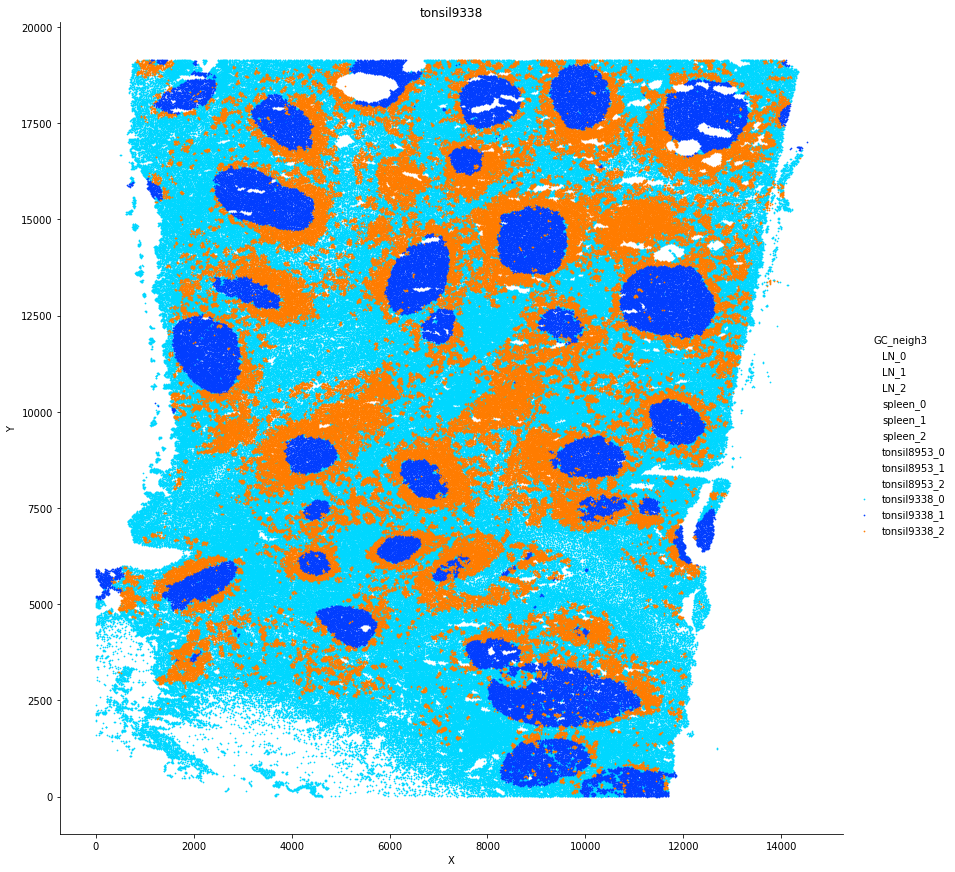

LN


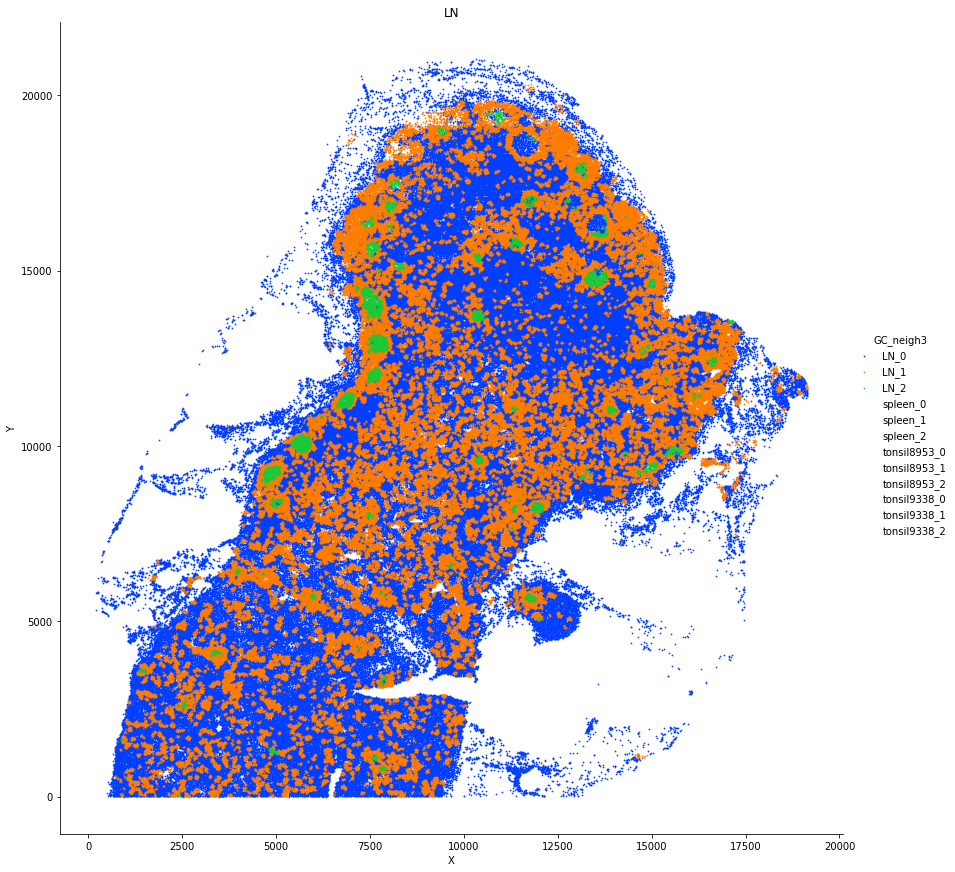

spleen


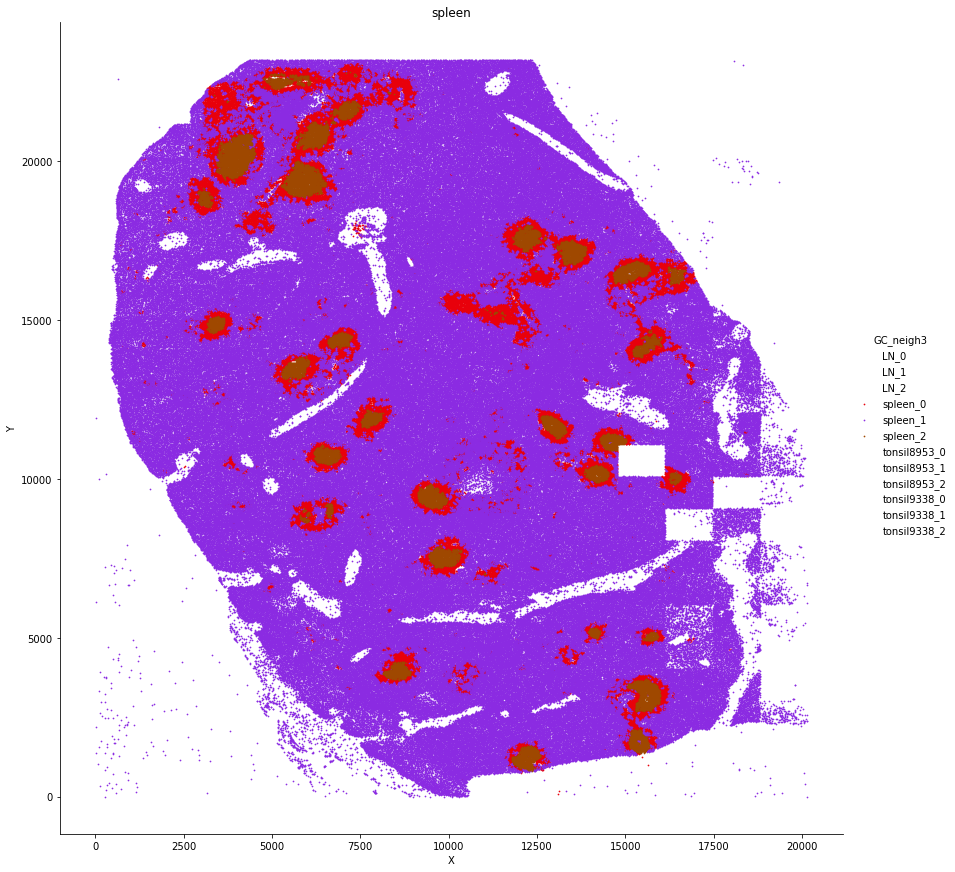

tonsil8953


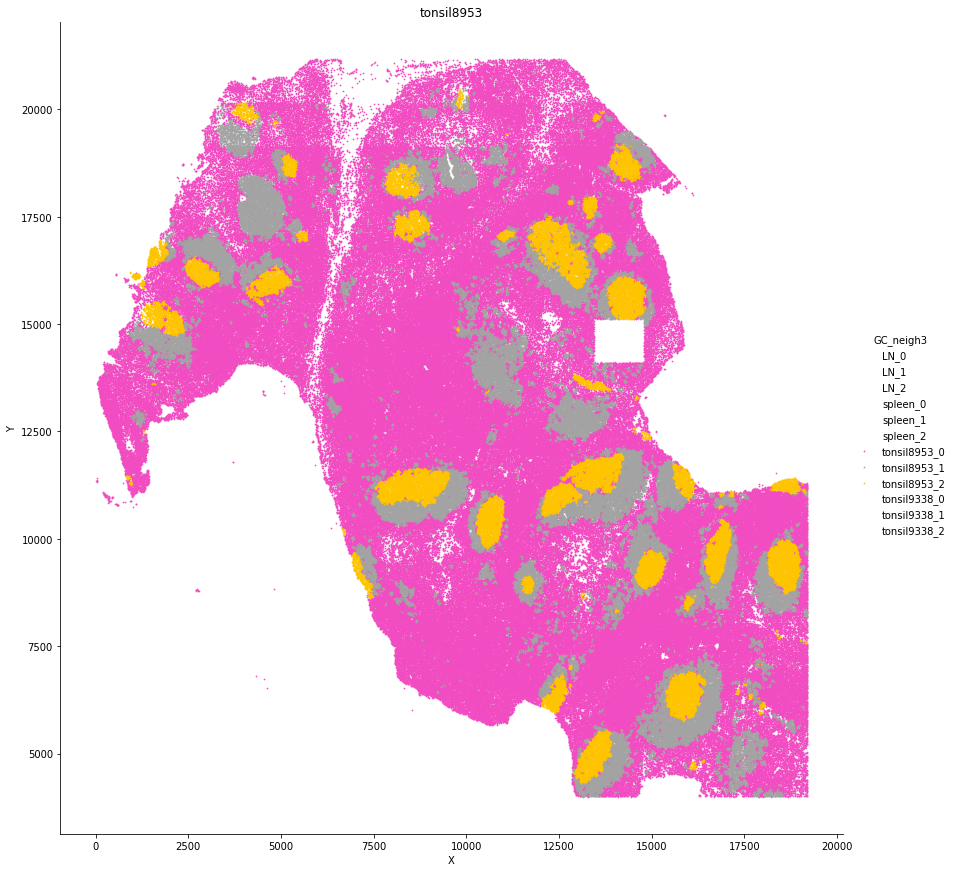

In [172]:
catplot(base,figsize = 12,size = 2,hue = 'GC_neigh3')

In [52]:
#select GC CNs for each tissue manually
keep_cn = [
    'tonsil9338_1',
    'tonsil8953_2',
    'LN_2',
    'spleen_2']
base_GC = base[(base['GC_neigh3'].isin(keep_cn))| (base['final_neigh2'].isin([10,'DZ']))]
base_GC['49_46_7'] = base_GC[[49,46,7]].sum(1)
base_GC['70_22'] = base_GC[[70,22]].sum(1)

/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [53]:
#use GC cell types to identify LZ and DZ
for n in [2]:
    for exp in exp_names:
        i = base_GC[base_GC['Exp']==exp]
        k = MiniBatchKMeans(n_clusters=n,random_state=2).fit(i[['49_46_7','70_22',61]])
        base_GC.loc[i.index,'subneigh{}'.format(n)] = ['{}_{}'.format(exp,j) for j in k.labels_]
    

/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/pandas/core/indexing.py:844: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/pandas/core/indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/pandas/core/indexing.py:965: SettingWithCopyWarning: 
A value 

tonsil9338


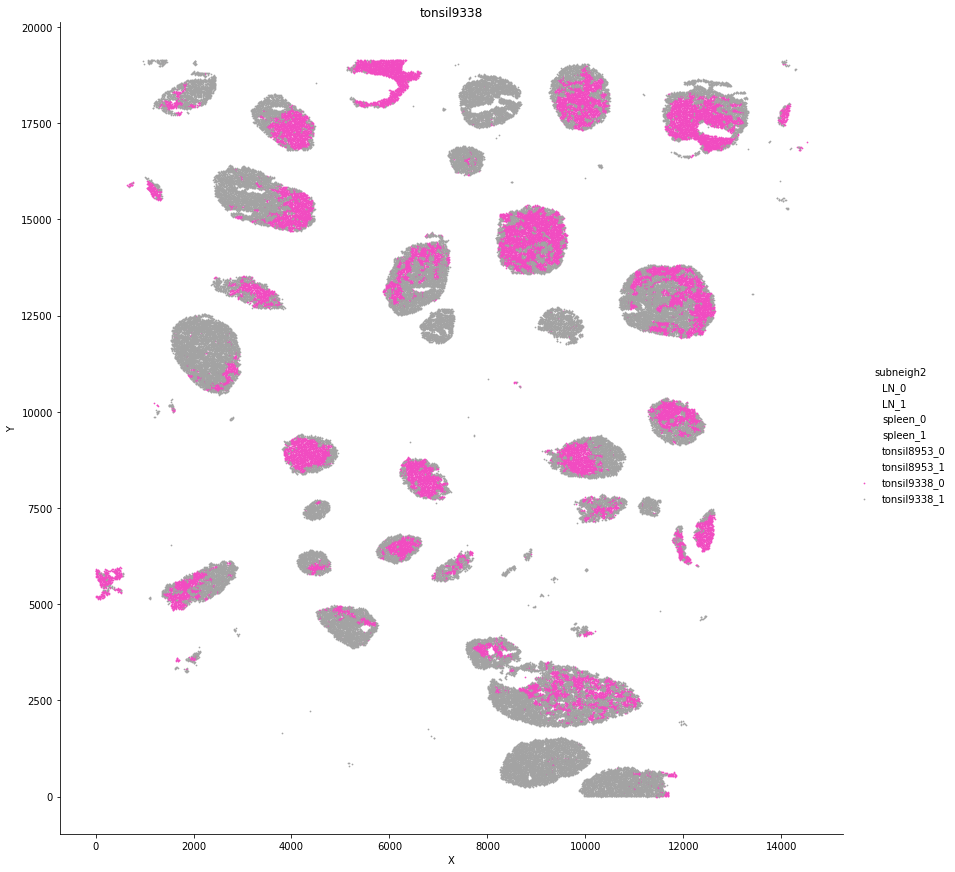

LN


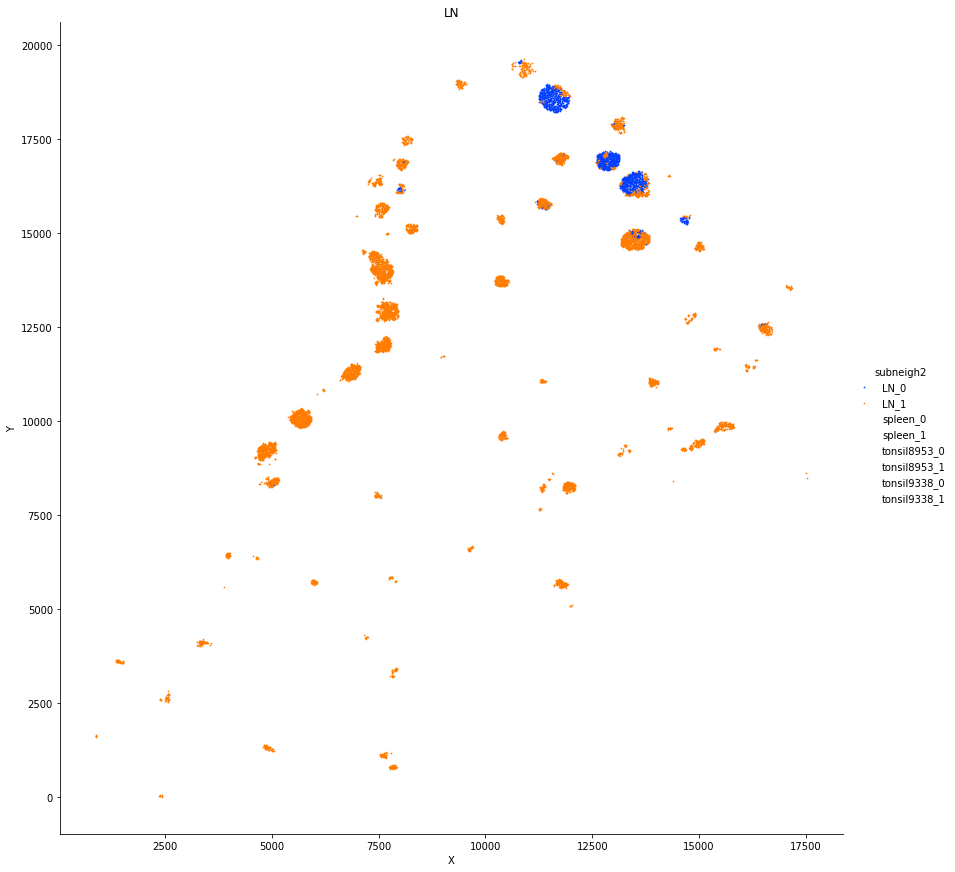

spleen


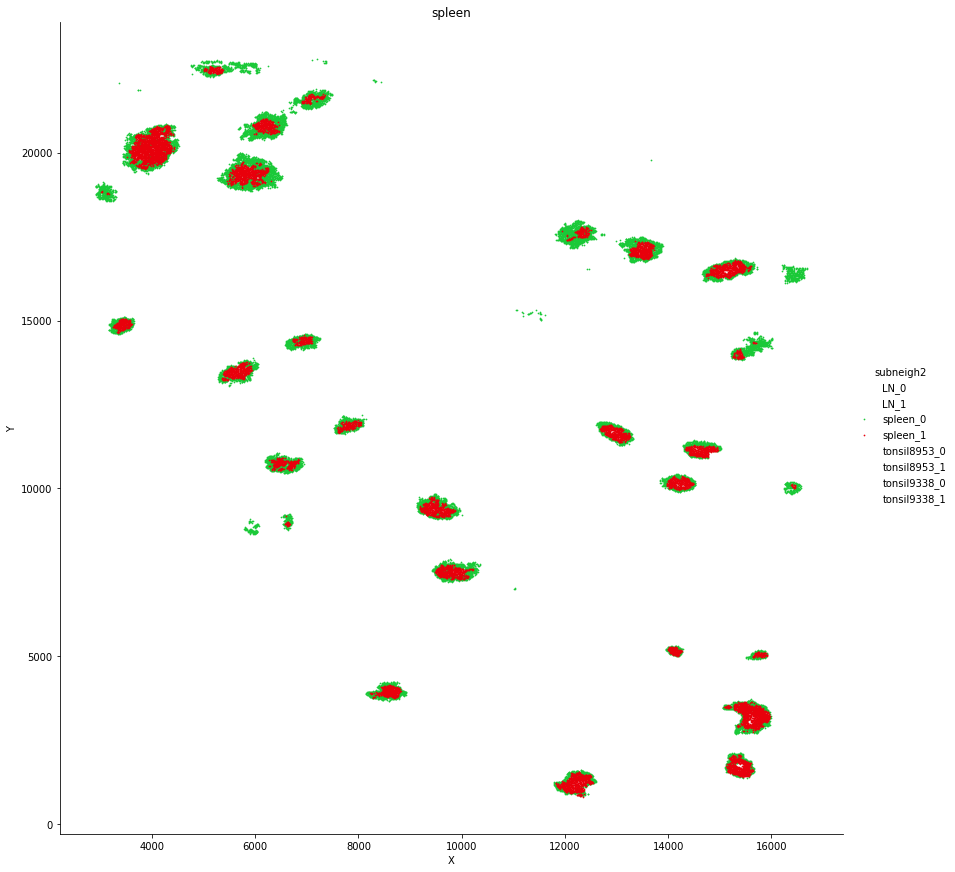

tonsil8953


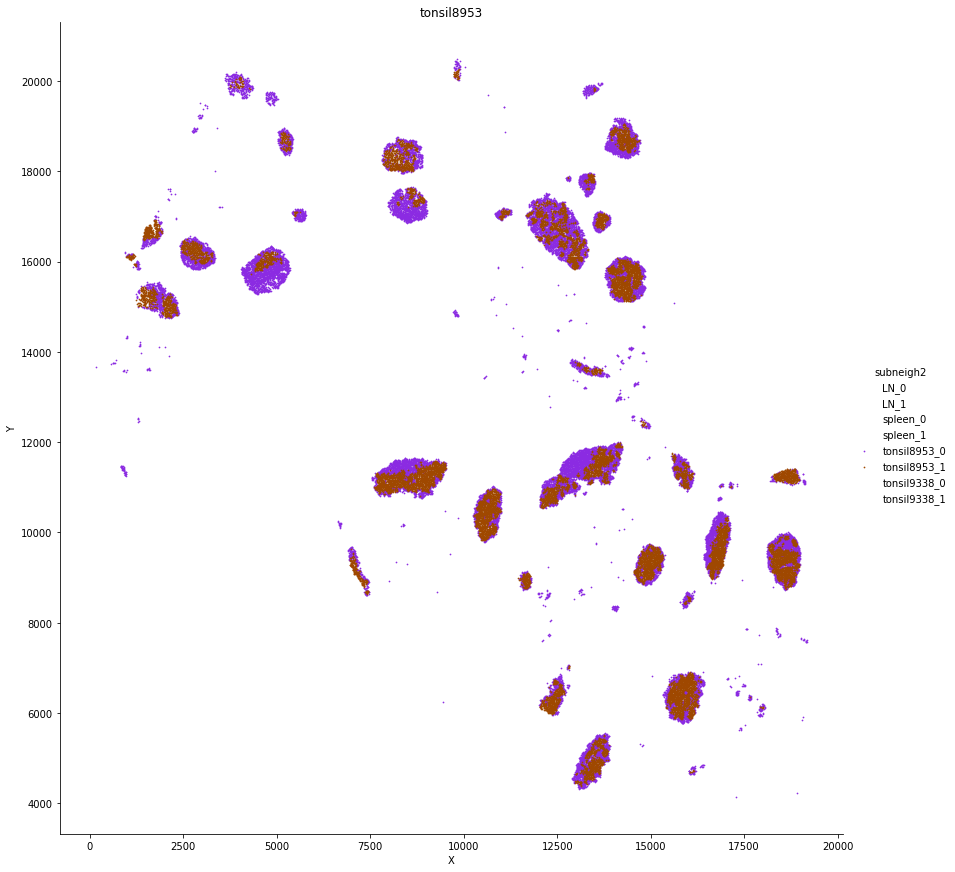

In [54]:
catplot(base_GC,hue = 'subneigh2',figsize = 12,size = 2)

In [55]:
#assign CNs to LZ or DZ
base_GC['final_subneigh'] = [{'tonsil9338_1':'LZ',
                             'tonsil9338_0':'DZ',
                             'tonsil8953_1':'LZ',
                             'tonsil8953_0':'DZ',
                              'LN_0':'DZ',
                              'LN_1':'LZ'
                             }.setdefault(i,'LZ') for i in base_GC['subneigh2']]

/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


tonsil9338


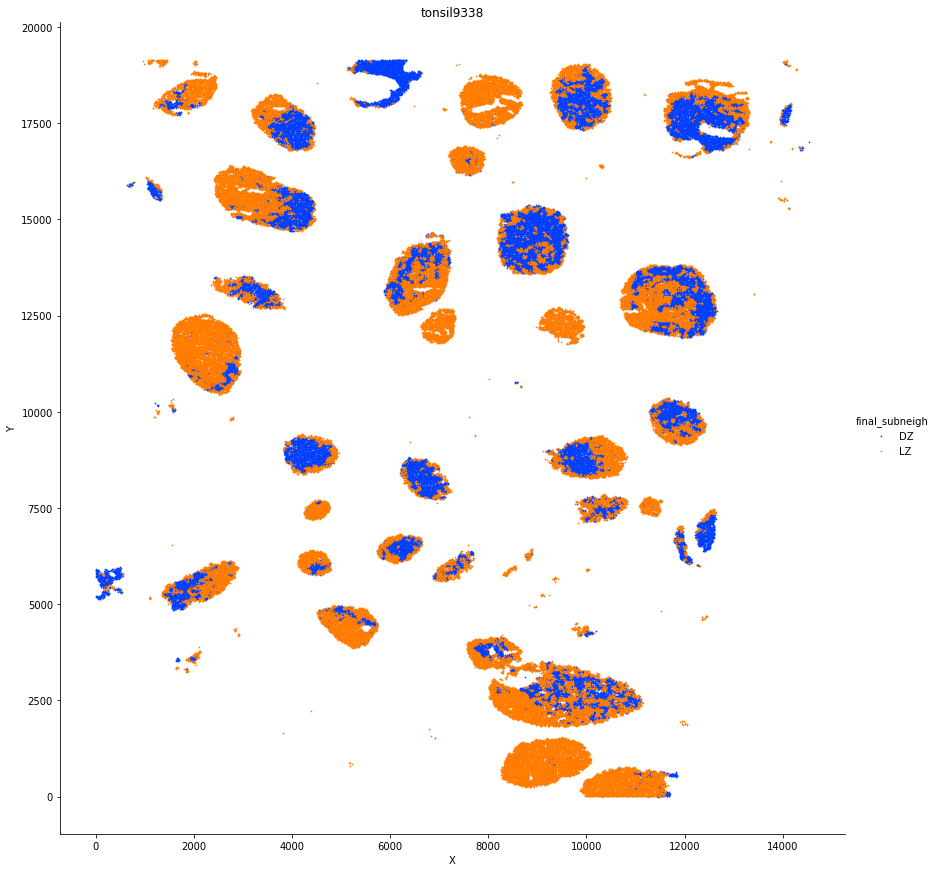

LN


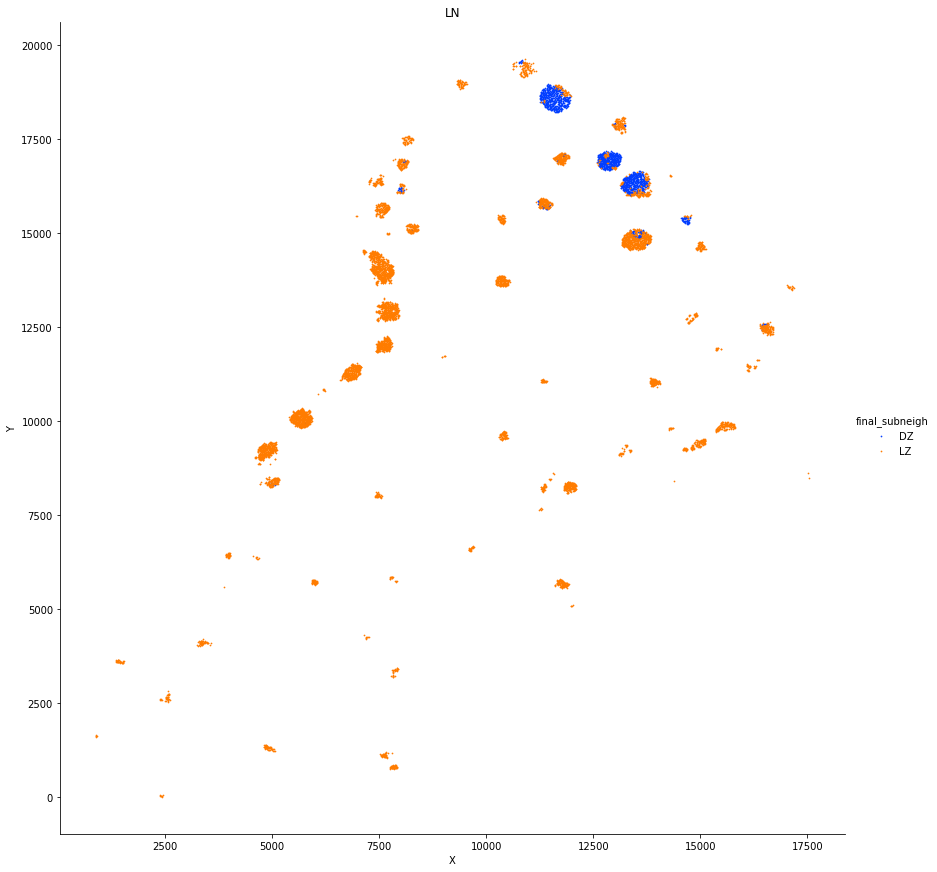

spleen


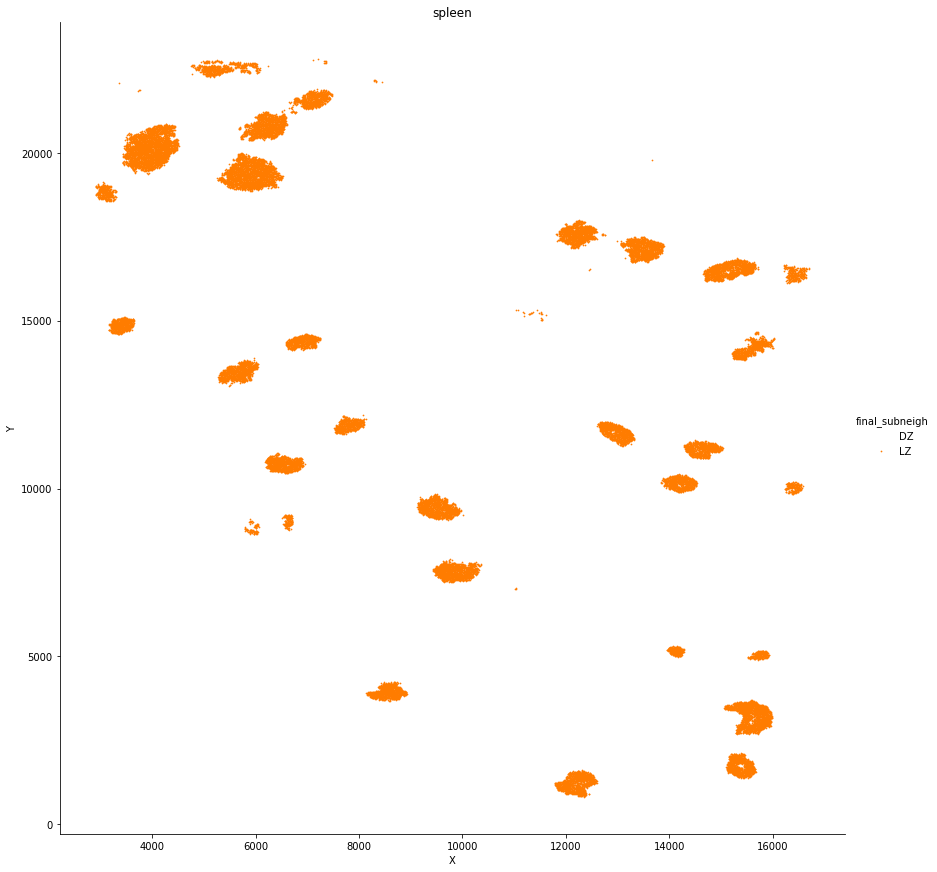

tonsil8953


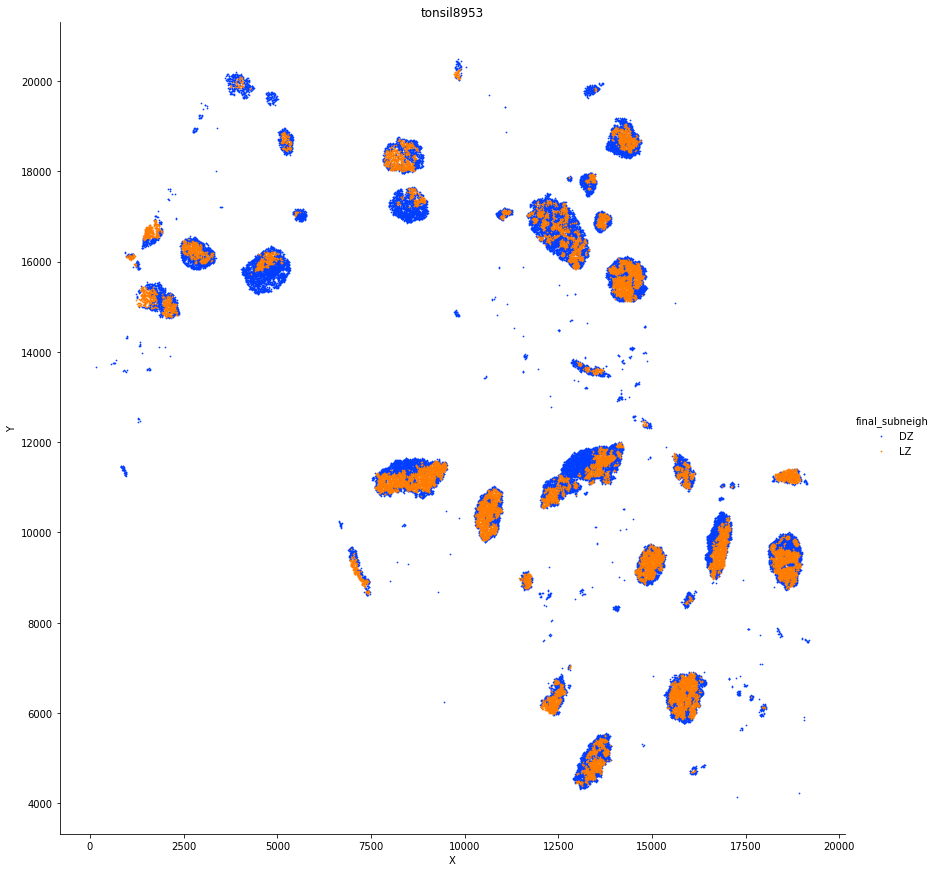

In [56]:
catplot(base_GC,hue = 'final_subneigh',figsize = 12,size = 2)

In [57]:
base_GC2 = base_GC[base_GC['final_neigh2'].isin([9,10,'DZ',8])]
gc_merged_after = BASE3.merge(base_GC2[['Exp','X','Y','final_subneigh','100','49_46_7','70_22',61]],on = ['Exp','X','Y'],how = 'left')


In [58]:
f = gc_merged_after[~gc_merged_after['final_subneigh'].isna()]
gc_merged_after['NEIGH'] = gc_merged_after['final_neigh2'].astype(str)
gc_merged_after.loc[f.index,'NEIGH'] = f['final_subneigh'].values

gc_merged_after['NEIGH'].value_counts()

3     392705
1     386073
5     262017
2     197966
7     139699
0     122743
4      92906
LZ     68459
8      68276
6      61105
DZ     58887
9         13
Name: NEIGH, dtype: int64

tonsil9338


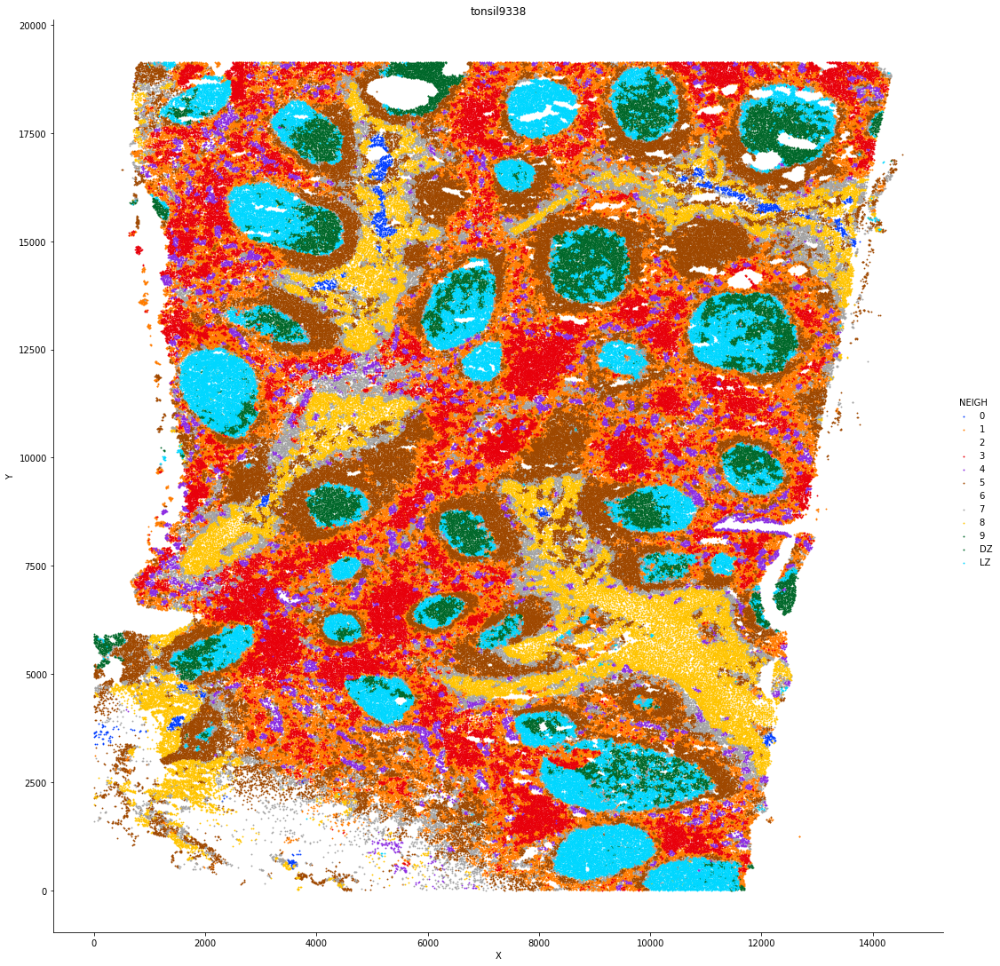

LN


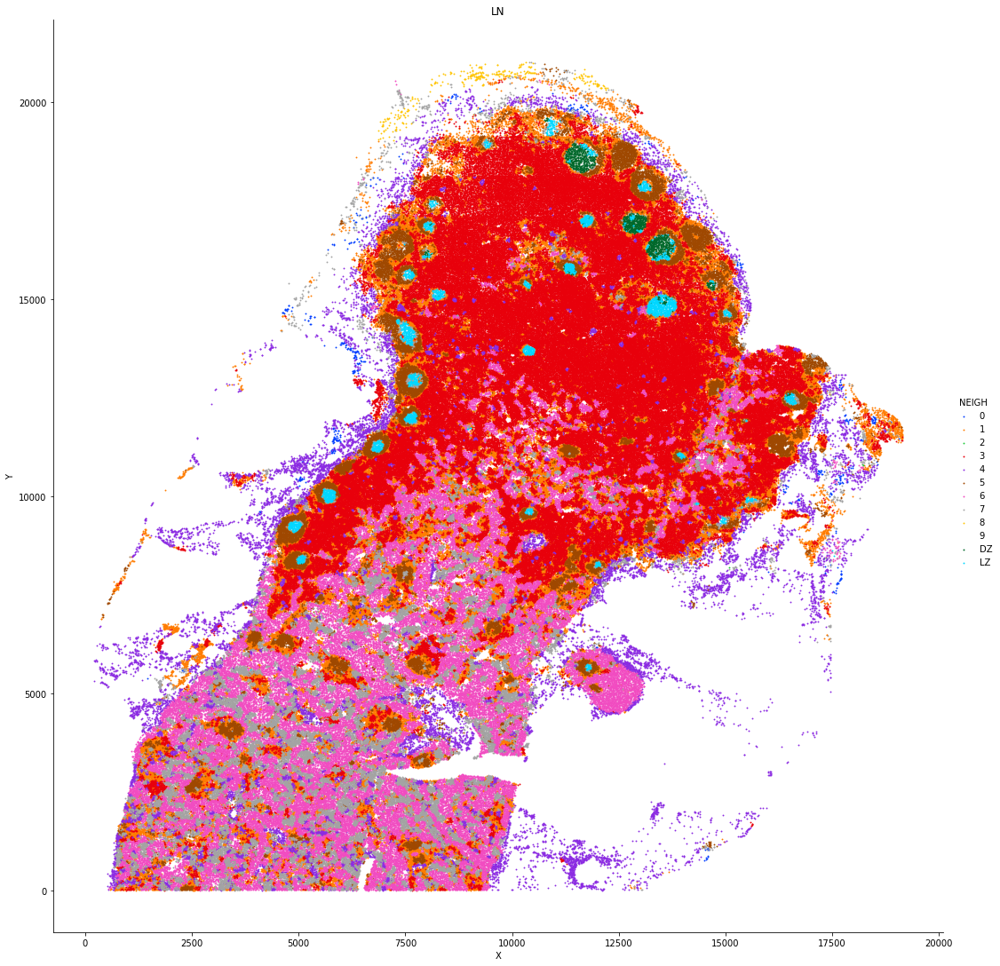

spleen


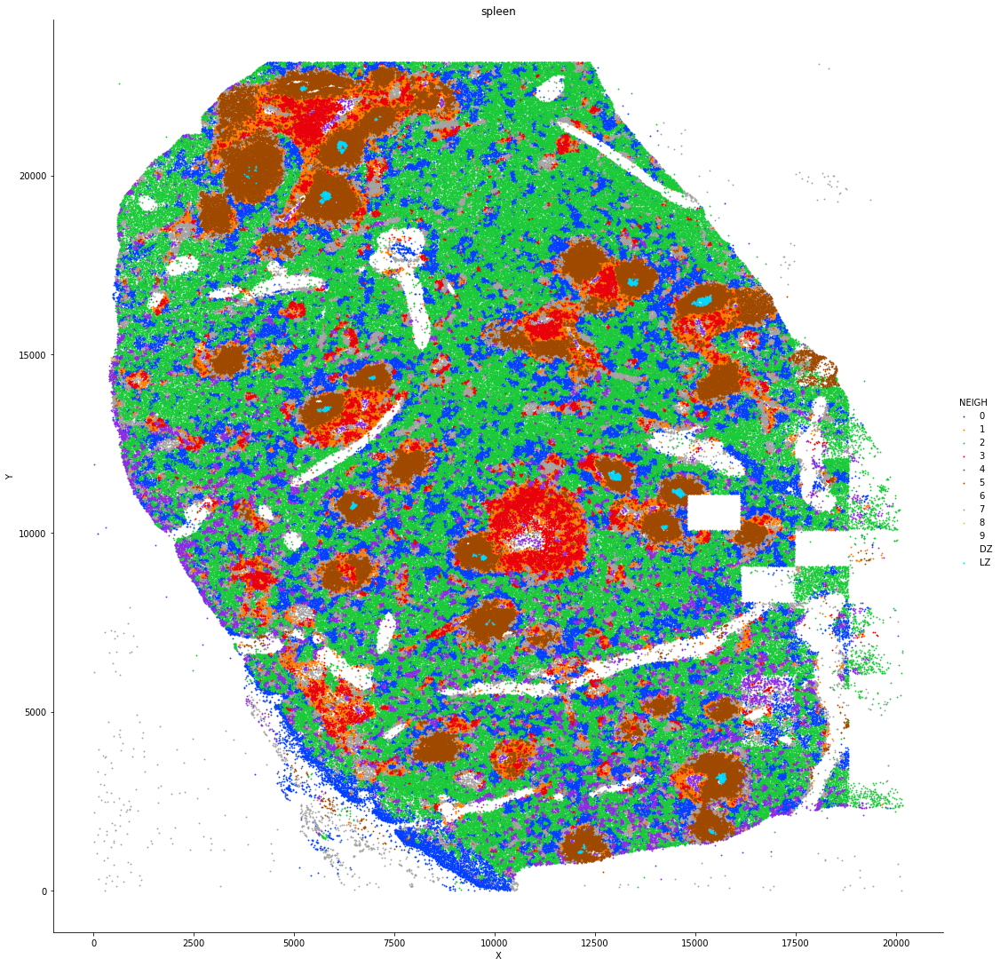

tonsil8953


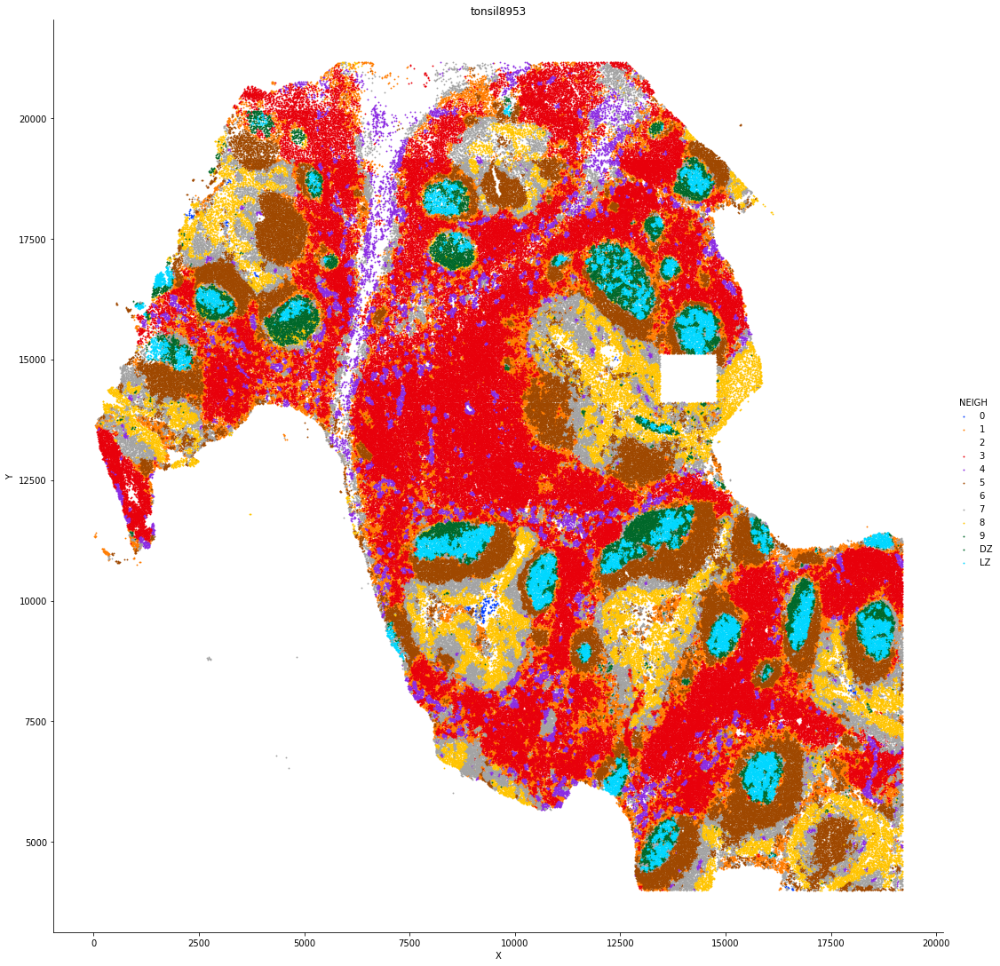

In [59]:
catplot(gc_merged_after,hue=  'NEIGH',palette = {str(k):v for k,v in pal.items()},figsize = 15,size =3)

## CNs using window sizes 10 and 30

In [60]:
NeighGC = Neighborhoods(cells,ks = [10,30],cluster_col = 'Cluster name2',
                      sum_cols=sum_cols,
                      keep_cols=keep_cols,X = 'X',Y='Y',add_dummies=True)
cluster_name2GC_windows = NeighGC.k_windows()

Starting: 3/4 : LN
Finishing: 3/4 : LN 2.7104666233062744 2.7108216285705566
Starting: 4/4 : spleen
Finishing: 4/4 : spleen 3.6545047760009766 6.385758876800537
Starting: 2/4 : tonsil8953
Finishing: 2/4 : tonsil8953 3.4101874828338623 9.824329853057861
Starting: 1/4 : tonsil9338
Finishing: 1/4 : tonsil9338 3.4375569820404053 13.28814148902893


In [61]:
for n in [2]:
    for exp in exp_names:
        i = base_GC[base_GC['Exp']==exp]
        k = MiniBatchKMeans(n_clusters=n,random_state=2).fit(i[['49_46_7','70_22',61]])
        base_GC.loc[i.index,'subneigh{}'.format(n)] = ['{}_{}'.format(exp,j) for j in k.labels_]
    

/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/pandas/core/indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/pandas/core/indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/pandas/core/indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on

In [67]:
newBase = BASE.loc[:,['Exp','X','Y','Cluster name2','100']]
gc = BASE3[BASE3['final_neigh2'].isin([10,'DZ'])]
gc = base[(base['GC_neigh3'].isin(keep_cn))& (base['final_neigh2'].isin([10,'DZ']))]

In [68]:
#identify CNs within GC using GC cts and outside GC using non GC cts andm erge
n_clusters = 11
n=2 
keep_cn = [
    'tonsil9338_1',
    'tonsil8953_2',
    'LN_2',
    'spleen_2']
base = foll_windows[20]
for k in [10,30]:
    
    X_ = cluster_name2_windows[k][cluster_cols].values
    #     X = transform_major_cells(X_,thresh = .2)
    X = X_/X_.sum(1,keepdims = True)
    X[np.isnan(X)] = 0
    print ('clustering - ws:{} n_clusters: {}'.format(k,n_clusters))
    col_name = 'cluster_col{}_ws{}_clusts{}_noECM'.format(cluster_col,k,n_clusters)
    assert col_name not in newBase.columns
    newBase[col_name] = MiniBatchKMeans(random_state = 5,n_clusters=n_clusters).fit(X).labels_

    base_GC = foll_windows[k][(base['GC_neigh3'].isin(keep_cn))& (base['final_neigh2'].isin([10,'DZ']))]
    base_GC['49_46_7'] = base_GC[[49,46,7]].sum(1)
    base_GC['70_22'] = base_GC[[70,22]].sum(1)

    gc_windows = base_GC
    for exp in exp_names:
        i = gc_windows[gc_windows['Exp']==exp]
        k = MiniBatchKMeans(n_clusters=n,random_state=2).fit(i[['49_46_7','70_22',61]])
        newBase.loc[i['index'].values,col_name] = ['{}_{}'.format(exp,j) for j in k.labels_]

    
    
    

/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


clustering - ws:10 n_clusters: 11


/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


clustering - ws:30 n_clusters: 11


/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/media/raid/conda_2020/miniconda3/envs/graham/hier3/lib/python3.7/site-packages/ipykernel_launcher.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [64]:
pali = {i:colors[i] for i in range(len(colors))}
for exp in exp_names:
    pali['{}_0'.format(exp)] = 'black'
    pali['{}_1'.format(exp)] = 'white'
    

In [69]:
newBase.head()

,Exp,X,Y,Cluster name2,100,cluster_colCluster name2_ws10_clusts11_noECM,cluster_colCluster name2_ws30_clusts11_noECM
0,tonsil9338,7.0,1605.0,B cells - (CD19/CD22/CD40),16,7,5
1,tonsil9338,77.0,1659.0,B cells - (CD19/CD22/CD40),14,7,5
2,tonsil9338,12.0,1992.0,B cells - (CD19/CD22/CD40),8,7,5
3,tonsil9338,86.0,1707.0,B cells - (CD19/CD22/CD40),8,7,5
4,tonsil9338,124.0,1676.0,B cells - (CD19/CD22/CD40),83,8,5


tonsil9338


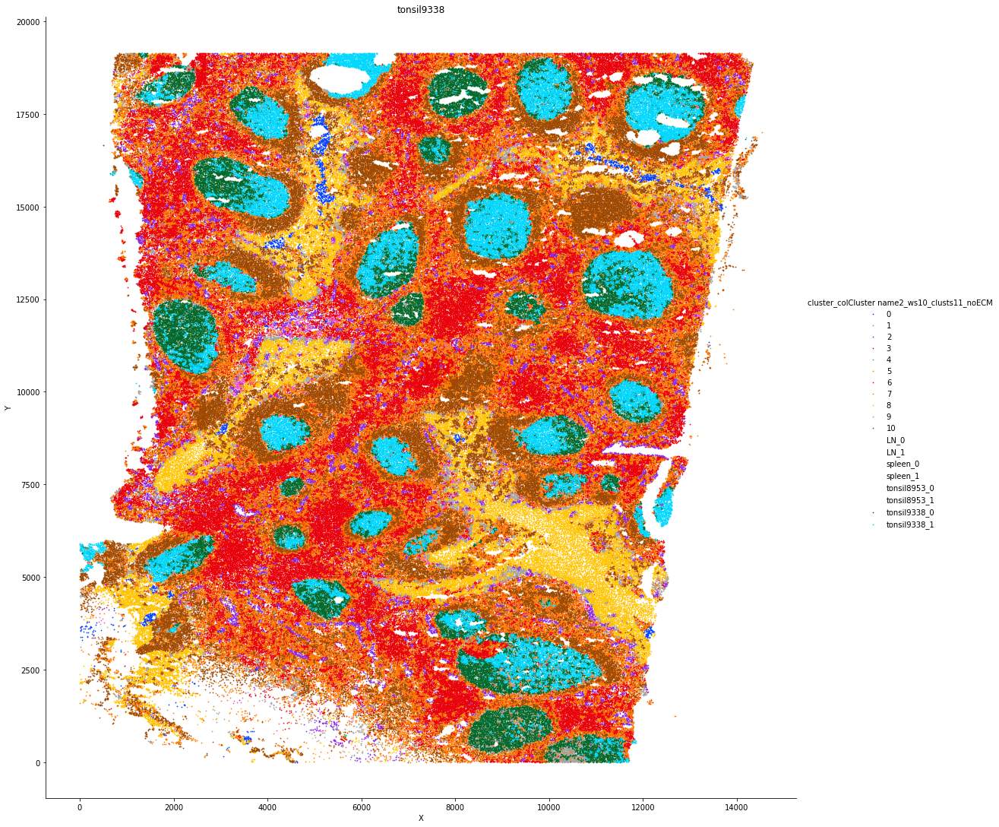

tonsil8953


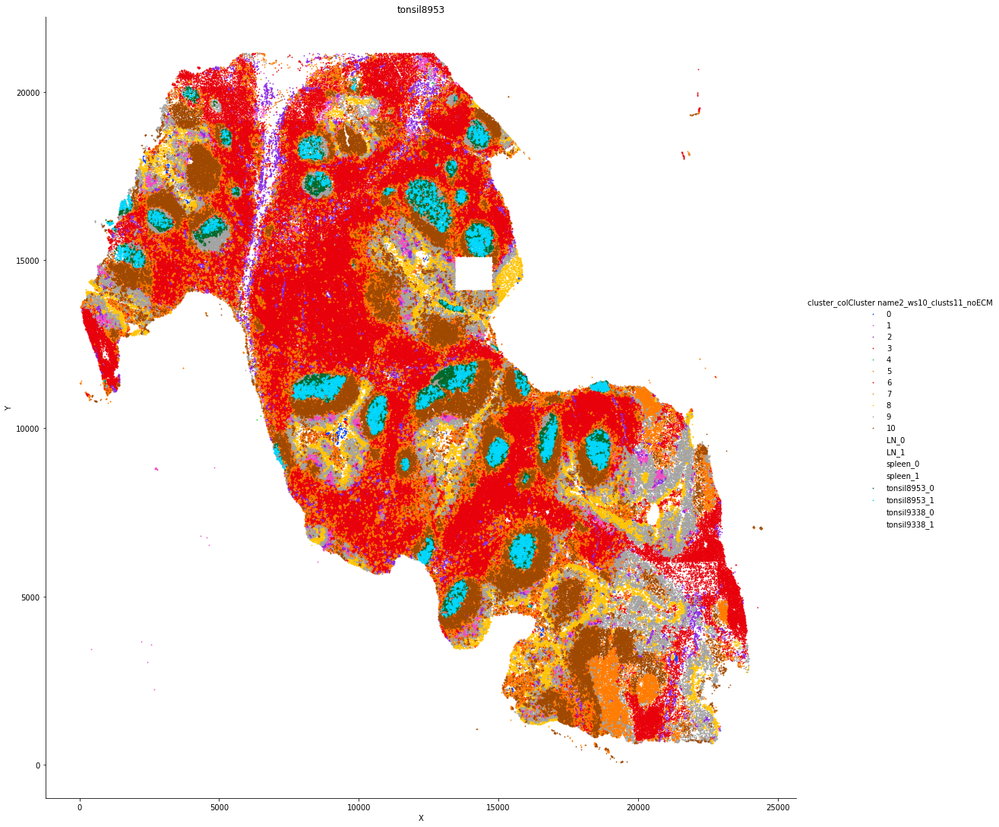

LN


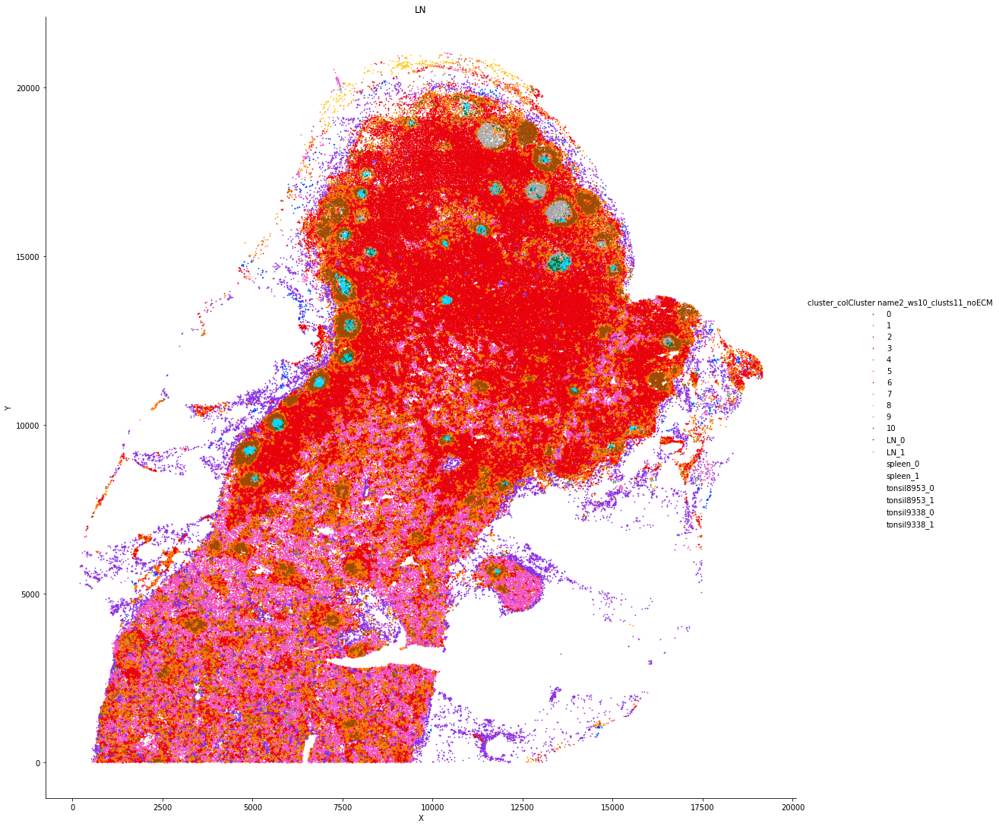

spleen


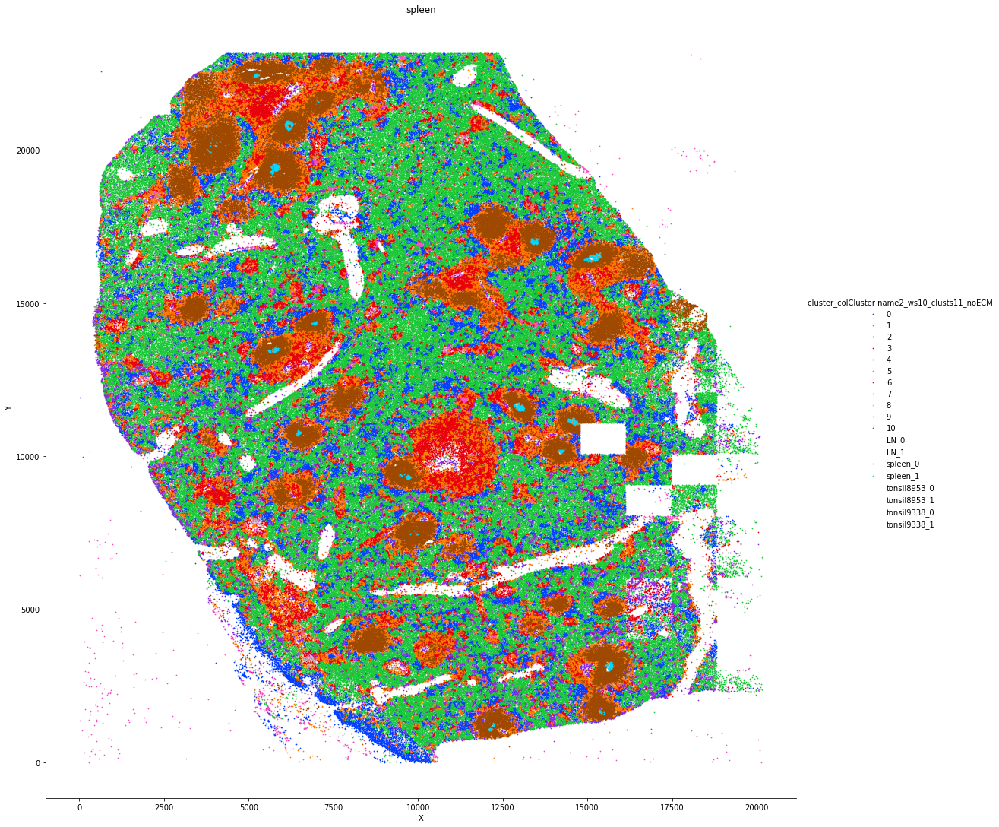

In [316]:
#manually assign colors to highlight correspondence with CNs in manuscript
pa = {0:colors[0],
           1:colors[6],
           2:colors[4],
           3:colors[3],
           4:colors[2],
           5:colors[1],
           6:colors[3],
           7:colors[1],
           8:colors[8],
           9:colors[7],
           10:colors[5],
           'tonsil9338_0':colors[10],
            'tonsil9338_1':colors[9],
            'tonsil8953_0':colors[10],
            'tonsil8953_1':colors[9],
            'LN_0':colors[10],
            'LN_1':colors[9],
            'spleen_0':colors[9],
            'spleen_1':colors[9]
          }

catplot(newBase,hue ='cluster_colCluster name2_ws10_clusts11_noECM',
        palette = pa,figsize = 15,size = 2
       )

tonsil9338


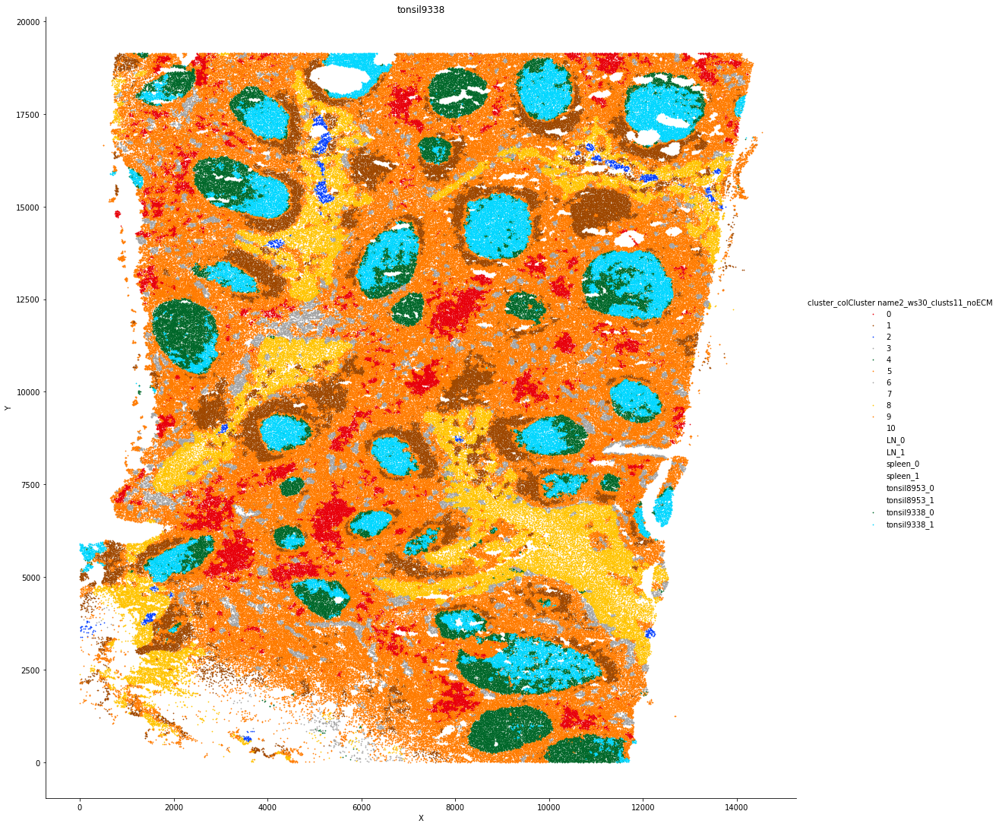

tonsil8953


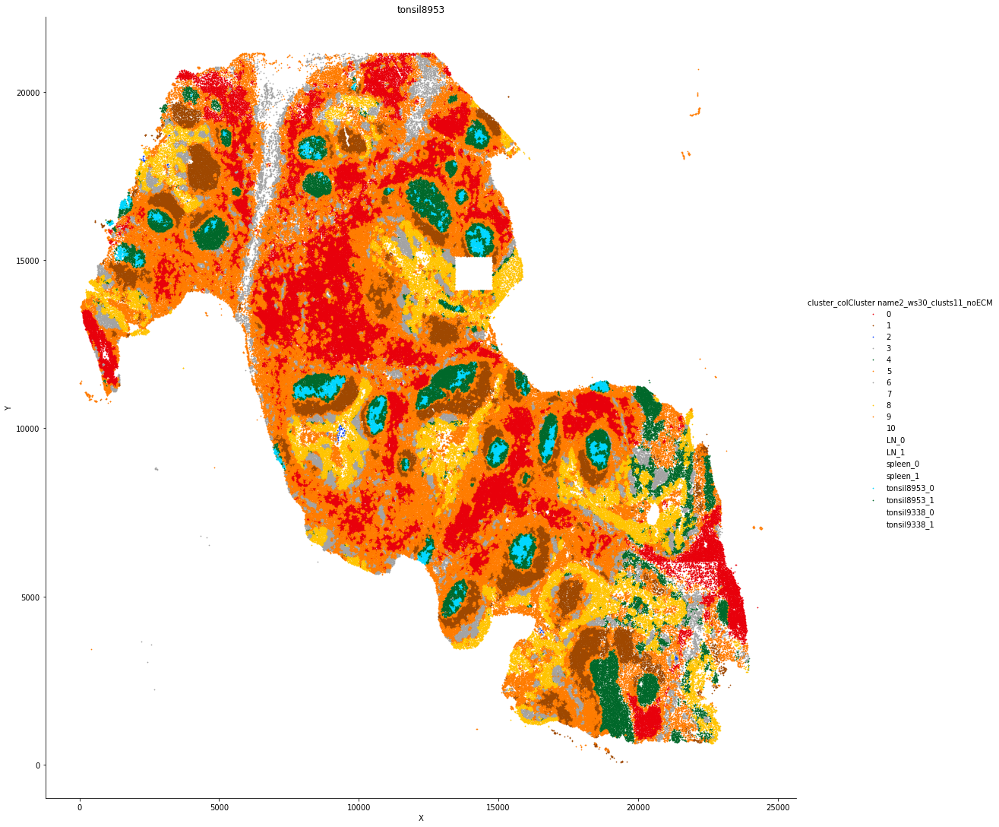

LN


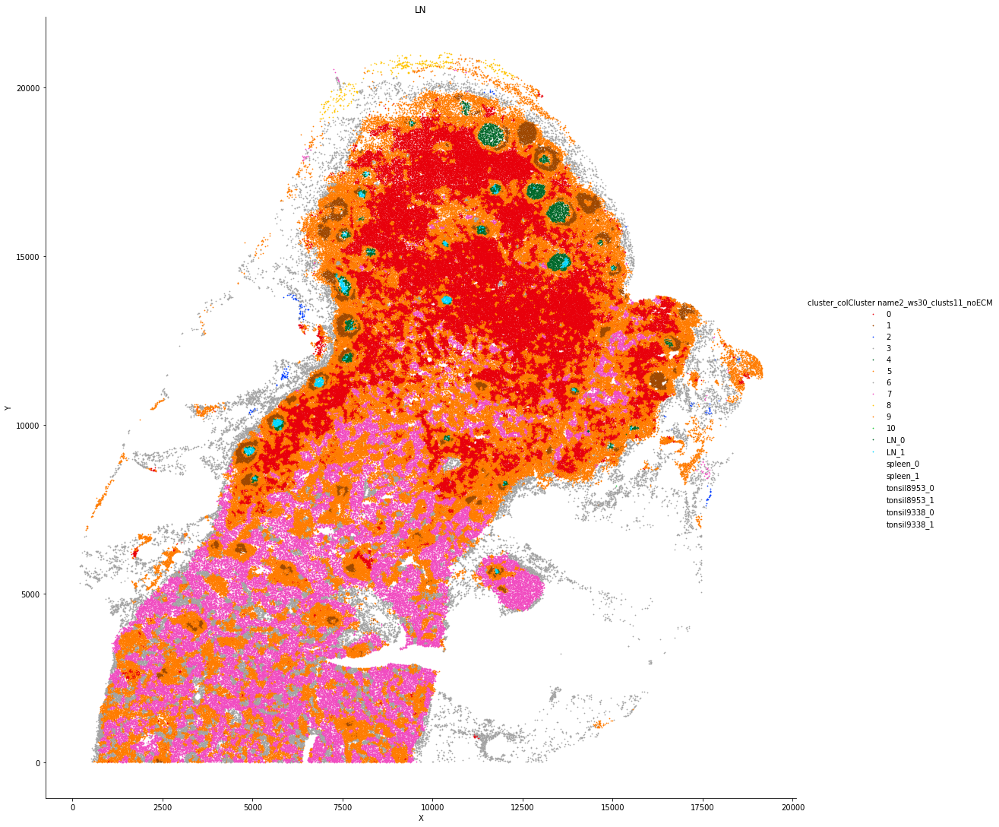

spleen


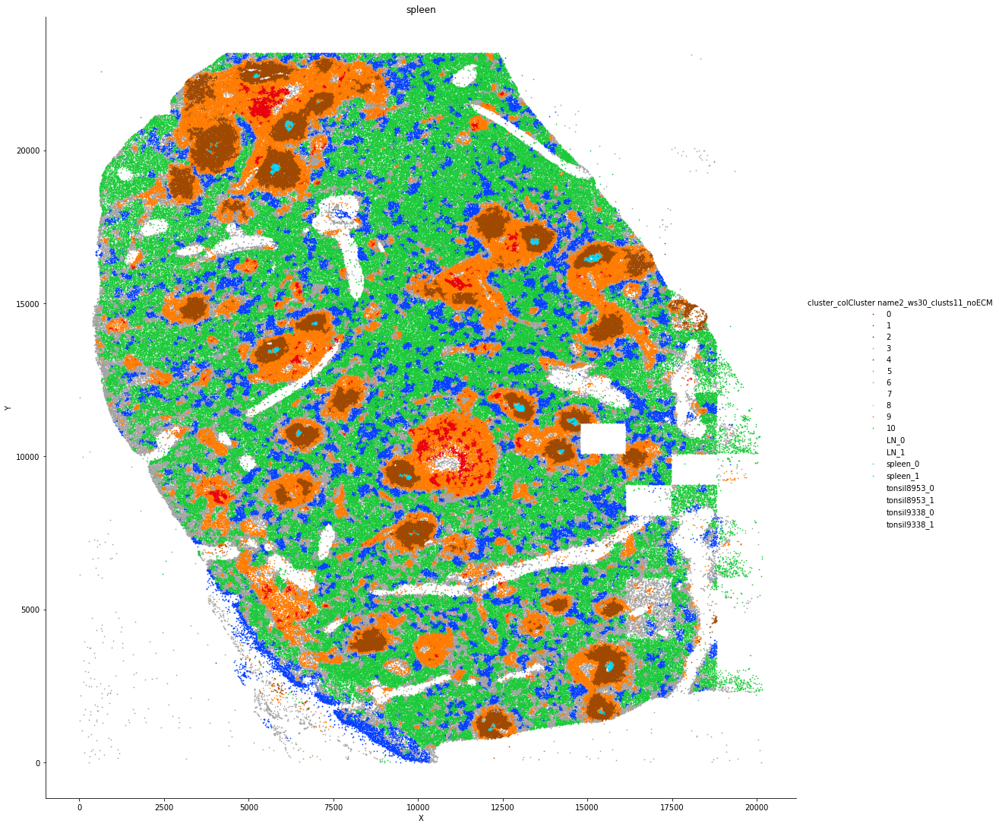

In [309]:
#manually assign colors to highlight correspondence with CNs in manuscript
pa = {0:colors[3],
           1:colors[5],
           2:colors[0],
           3:colors[7],
           4:colors[10],
           5:colors[1],
           6:colors[7],
           7:colors[6],
           8:colors[8],
           9:colors[1],
           10:colors[2],
           'tonsil9338_0':colors[10],
            'tonsil9338_1':colors[9],
            'tonsil8953_0':colors[9],
            'tonsil8953_1':colors[10],
            'LN_0':colors[10],
            'LN_1':colors[9],
            'spleen_0':colors[9],
            'spleen_1':colors[9]
          }
catplot(newBase,hue ='cluster_colCluster name2_ws30_clusts11_noECM',
        palette = pa,figsize = 15,size = 2
       )